In [3]:

!pip install tensorboardX

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 2.4 MB/s eta 0:00:00


In [4]:
!wget -q https://storage.googleapis.com/open_source_datasets/ShelfImages.tar.gz
!tar xf ShelfImages.tar.gz

In [5]:
!wget -q https://github.com/gulvarol/grocerydataset/releases/download/1.0/GroceryDataset_part2.tar.gz
!tar xf GroceryDataset_part2.tar.gz

In [6]:

!ls -lh ShelfImages | head -10
!ls -lh ShelfImages/train | head -10
!ls -lh ShelfImages/test | head -10

total 20K
drwxrwxr-x 2 1001 1001 4.0K Sep 24 17:16 test
drwxrwxr-x 2 1001 1001  16K Sep 24 17:16 train
total 456M
-rw-r--r-- 1 1001 1001  645K Oct 23  2019 C1_P01_N1_S2_1.JPG
-rw-r--r-- 1 1001 1001  2.1M Oct 23  2019 C1_P01_N1_S2_2.JPG
-rw-r--r-- 1 1001 1001  1.1M Oct 23  2019 C1_P01_N1_S3_1.JPG
-rw-r--r-- 1 1001 1001  870K Oct 23  2019 C1_P01_N1_S3_2.JPG
-rw-r--r-- 1 1001 1001  907K Oct 23  2019 C1_P01_N1_S5_1.JPG
-rw-r--r-- 1 1001 1001  2.1M Oct 23  2019 C1_P01_N2_S2_1.JPG
-rw-r--r-- 1 1001 1001  1.3M Oct 23  2019 C1_P01_N2_S3_1.JPG
-rw-r--r-- 1 1001 1001  1.1M Oct 23  2019 C1_P01_N2_S4_1.JPG
-rw-r--r-- 1 1001 1001  2.0M Oct 23  2019 C1_P01_N3_S2_1.JPG
total 101M
-rw-r--r-- 1 1001 1001 1.6M Oct 23  2019 C1_P02_N1_S5_1.JPG
-rw-r--r-- 1 1001 1001 2.3M Oct 23  2019 C1_P02_N2_S2_1.JPG
-rw-r--r-- 1 1001 1001 2.3M Oct 23  2019 C1_P02_N2_S3_1.JPG
-rw-r--r-- 1 1001 1001 1.3M Oct 23  2019 C1_P03_N1_S2_1.JPG
-rw-r--r-- 1 1001 1001 1.6M Oct 23  2019 C1_P03_N1_S3_1.JPG
-rw-r--r-- 1 1001 1001 2.4

In [7]:
from imutils import paths
from typing import List
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os
from tqdm import tqdm
import torch

print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 2.0.1+cu118 CPU


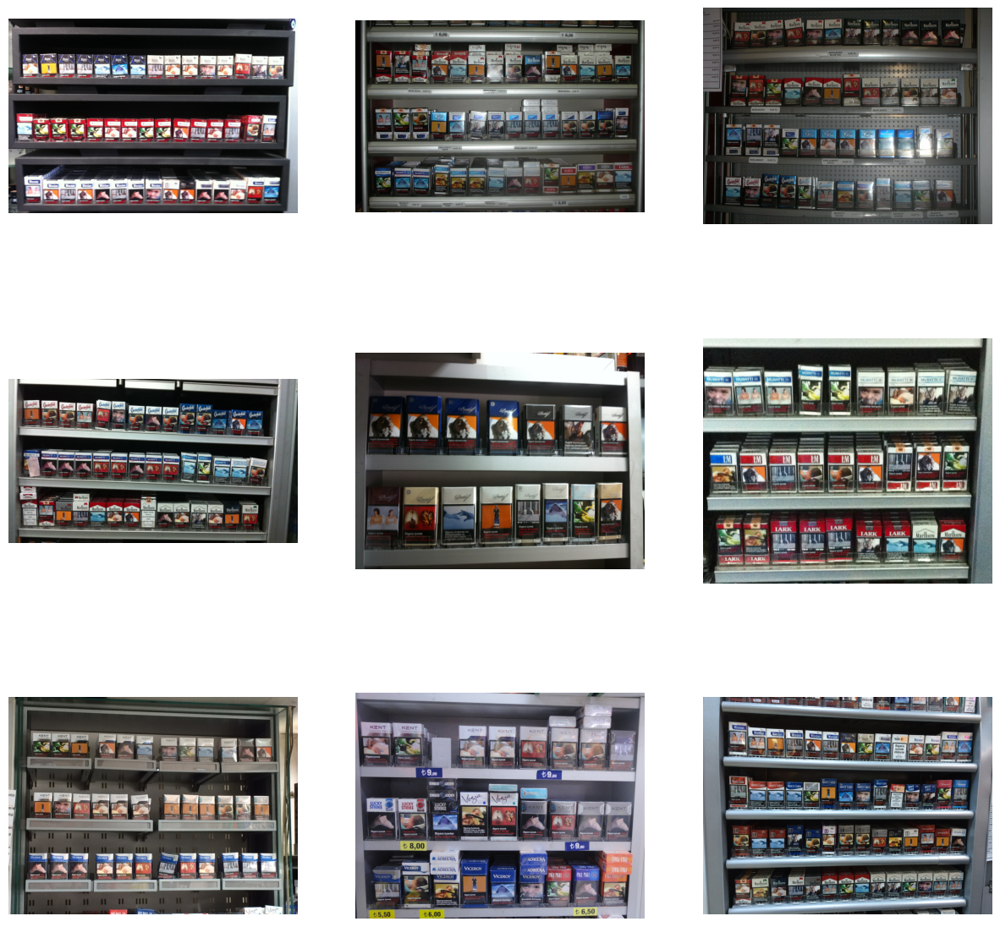

In [8]:
train_images = list(paths.list_images("ShelfImages/train"))
plt.figure(figsize=(15, 15))
for i, image  in enumerate(train_images[:9]):
    image = plt.imread(image)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(image)
    plt.axis("off")

In [9]:
cols = ["image_name", "x_i", "y_i", "w_i", "h_i", "b_i"]
master_df = pd.read_csv("https://raw.githubusercontent.com/gulvarol/grocerydataset/master/annotations.csv",
                        names=cols)
master_df.head()

,image_name,x_i,y_i,w_i,h_i,b_i
0,C1_P01_N1_S2_1.JPG,1008,1552,1260,1928,0
1,C1_P01_N1_S2_1.JPG,1028,928,1280,1304,0
2,C1_P01_N1_S2_1.JPG,24,872,268,1264,0
3,C1_P01_N1_S2_1.JPG,280,1568,532,1944,0
4,C1_P01_N1_S2_1.JPG,292,872,544,1248,0


In [10]:
master_df

,image_name,x_i,y_i,w_i,h_i,b_i
0,C1_P01_N1_S2_1.JPG,1008,1552,1260,1928,0
1,C1_P01_N1_S2_1.JPG,1028,928,1280,1304,0
2,C1_P01_N1_S2_1.JPG,24,872,268,1264,0
3,C1_P01_N1_S2_1.JPG,280,1568,532,1944,0
4,C1_P01_N1_S2_1.JPG,292,872,544,1248,0
...,...,...,...,...,...,...
13179,C4_P08_N3_S3_2.JPG,1456,416,1688,736,2
13180,C4_P08_N3_S3_2.JPG,1684,420,1916,740,2
13181,C4_P08_N3_S3_2.JPG,1904,424,2136,744,2
13182,C4_P08_N3_S3_2.JPG,1432,1636,1664,1972,9


In [11]:
master_df["b_i"].unique()

array([ 0,  1,  4,  7,  3,  6, 10,  2,  5,  8,  9])

In [12]:
def vis_annotations(image_path: str, coordinate_list: List[List[int]],
                    color: str="blue") -> None:
    """Converts bounding box to matplotlib format, imposes it on the
    provided image and then displays the plot."""
    image = plt.imread(image_path)
    fig = plt.imshow(image)
    for i in range(len(coordinate_list)):
        bbox = coordinate_list[i]
        fig.axes.add_patch(plt.Rectangle(
            xy=(bbox[0], bbox[1]), width=bbox[2]-bbox[0], height=bbox[3]-bbox[1],
            fill=False, edgecolor=color, linewidth=2))
    plt.show()

In [13]:
train_images[0]

'ShelfImages/train/C2_P01_N2_S3_2.JPG'

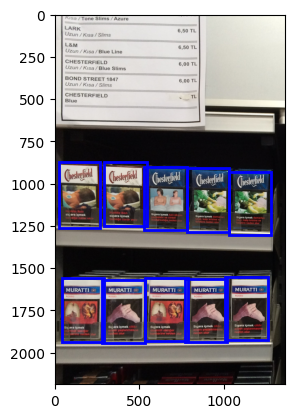

In [14]:
coordinate_columns = master_df.columns[1:-1]
coordinate_list = master_df[master_df["image_name"]=="C1_P01_N1_S2_1.JPG"][coordinate_columns]
coordinate_list = coordinate_list.values.tolist()
vis_annotations("ShelfImages/train/C1_P01_N1_S2_1.JPG", coordinate_list)

In [15]:
train_images = list(paths.list_images("ShelfImages/train"))
test_images = list(paths.list_images("ShelfImages/test"))
train_image_names = [image_path.split("/")[-1] for image_path in train_images]
test_image_names = [image_path.split("/")[-1] for image_path in test_images]
print(len(train_image_names), len(test_image_names))

283 71


In [16]:
train_df = master_df[master_df["image_name"].isin(train_image_names)]
test_df = master_df[~master_df["image_name"].isin(train_image_names)]
print(len(np.unique(train_df["image_name"])), len(np.unique(test_df["image_name"])))

283 71


In [17]:
# Let's turn the image names into absolute paths
train_df["image_name"] = train_df["image_name"].map(lambda x: "ShelfImages/train/" + x)
test_df["image_name"] = test_df["image_name"].map(lambda x: "ShelfImages/test/" + x)

<ipython-input-17-5339d736f7f4>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df["image_name"] = train_df["image_name"].map(lambda x: "ShelfImages/train/" + x)
<ipython-input-17-5339d736f7f4>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df["image_name"] = test_df["image_name"].map(lambda x: "ShelfImages/test/" + x)


In [18]:
# Preview
train_counts = len(train_df['image_name'].unique())
test_counts = len(test_df['image_name'].unique())
print(f'Total Unique train images {train_counts}')
print(f'Total Unique test images {test_counts}')

Total Unique train images 283
Total Unique test images 71


In [19]:
# it takes class label, xy, wh
def form_line(cls, x, y, w, h):
  line = str(cls)+' '+ str(x) +' '+ str(y) + ' ' + str(w) + ' ' + str(h) + '\n'
  return line

In [20]:
train_df['b_i'].unique()

array([ 0,  1,  4,  7,  3,  6, 10,  2,  5,  8,  9])

In [21]:
# fetch list of train images in the shelf images dataset
train_images = sorted(train_df['image_name'].unique())
# fetch list of test images in the shelf images dataset
test_images = sorted(test_df['image_name'].unique())

# destination train image path
dst_train_path = os.path.join('/content/Prep_data/train', 'images')
# destination test image path
dst_test_path = os.path.join('/content/Prep_data/test', 'images')
# train annotation path
annot_train = os.path.join('/content/Prep_data/train', 'labels')
# test annotation path
annot_test = os.path.join('/content/Prep_data/test', 'labels')

# prepare destination directory
if not os.path.isdir('/content/Prep_data'):
  os.mkdir('/content/Prep_data')
  # train and test path
  os.mkdir('/content/Prep_data/train')
  os.mkdir('/content/Prep_data/test')

def fetch_annotation(img_path, df):
  img_id = img_path.split('/')[-1]
  img_w, img_h = np.flip(plt.imread(img_path).shape[:2])[:2]
  lines = ''
  for record in np.array(df[df['image_name']==img_path]):
    #print(f'Image name {img_id}')
    class_label = record[-1]
    w = record[3] - record[1]
    h = record[4] - record[2]
    c_x = record[1] + (w/2)
    c_y = record[2] + (h/2)
    x_norm = c_x/(img_w)
    y_norm = c_y/(img_h)
    w_norm = w/img_w
    h_norm = h/img_h
    lines+= form_line(class_label, x_norm, y_norm, w_norm, h_norm)
  return img_id, lines

# create annotation files
def data_prep(annot_path, dst_img_path, img_paths, df):
  # if annotation folder not exists
  if not os.path.isdir(annot_path):
    os.mkdir(annot_path)
  # if seperate image folder not exists
  if not os.path.isdir(dst_img_path):
    os.mkdir(dst_img_path)

  for img_path in tqdm(img_paths):
    img = plt.imread(img_path)
    img_id, lines = fetch_annotation(img_path, df)
    plt.imsave(os.path.join(dst_img_path, img_id), img)

    img_name = img_id.split('.')[0]
    annot_img_file = os.path.join(annot_path, img_name)+'.txt'
    if not os.path.isfile(annot_img_file):
      with open(annot_img_file, 'x') as f:
        f.write(lines)

  assert len(os.listdir(annot_path)) == len(os.listdir(dst_img_path))
  print('\nCheck passed!')

In [22]:
data_prep(annot_train, dst_train_path, train_images, train_df)

100%|██████████| 283/283 [01:18<00:00,  3.60it/s]


Check passed!


In [23]:
data_prep(annot_test, dst_test_path, test_images, test_df)

100%|██████████| 71/71 [00:20<00:00,  3.47it/s]


Check passed!


In [24]:
pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 618.0/618.0 kB 3.4 MB/s eta 0:00:00


In [25]:
from ultralytics import YOLO

In [26]:
model  = YOLO('yolov8n.pt')


100%|██████████| 6.23M/6.23M [00:00<00:00, 65.9MB/s]


In [27]:
import yaml

# Define the content as a Python dictionary
data = {
    "train": "/content/Prep_data/train/images",
    "val": "/content/Prep_data/test/images",
    "nc": 11,
    "names": ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10']
}

# Specify the file path
file_path = "/content/drive/MyDrive/config.yaml"

# Write the YAML data to the file
with open(file_path, "w") as yaml_file:
    yaml.dump(data, yaml_file)

print(f"YAML file has been created at: {file_path}")


YAML file has been created at: /content/drive/MyDrive/config.yaml


In [28]:
%cat /content/drive/MyDrive/config.yaml

names:
- '0'
- '1'
- '2'
- '3'
- '4'
- '5'
- '6'
- '7'
- '8'
- '9'
- '10'
nc: 11
train: /content/Prep_data/train/images
val: /content/Prep_data/test/images


In [29]:
model.train(data = "/content/drive/MyDrive/config.yaml",epochs = 30, batch = 4)

Ultralytics YOLOv8.0.185 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/config.yaml, epochs=30, patience=50, batch=4, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, o

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78a6506417b0>
fitness: 0.2966220581865402
keys: ['metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)']
maps: array([    0.75074,     0.72286,     0.74807,    0.028806,     0.11145,     0.01106,    0.034245,     0.60787,     0.14398,   0.0014559,   0.0040817])
names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: '10'}
plot: True
results_dict: {'metrics/precision(B)': 0.8280529485317314, 'metrics/recall(B)': 0.3354347284566431, 'metrics/mAP50(B)': 0.37699137506010716, 'metrics/mAP50-95(B)': 0.2876921340894772, 'fitness': 0.2966220581865402}
save_dir: PosixPath('runs/detect/train')
speed: {'preprocess': 3.014880166926854, 'inference': 282.6974626997827, 'loss': 0.0005104172

In [41]:
from ultralytics import YOLO
model = YOLO("/content/runs/detect/train/weights/best.pt")
source ="/content/Prep_data/test/images"
model.predict(source, save=True, imgsz = 896, conf=0.5)




image 1/71 /content/Prep_data/test/images/C1_P02_N1_S5_1.JPG: 864x896 48 0s, 429.3ms
image 2/71 /content/Prep_data/test/images/C1_P02_N2_S2_1.JPG: 672x896 28 0s, 312.5ms
image 3/71 /content/Prep_data/test/images/C1_P02_N2_S3_1.JPG: 672x896 30 0s, 300.8ms
image 4/71 /content/Prep_data/test/images/C1_P03_N1_S2_1.JPG: 512x896 19 0s, 7 2s, 239.8ms
image 5/71 /content/Prep_data/test/images/C1_P03_N1_S3_1.JPG: 608x896 32 0s, 5 2s, 278.0ms
image 6/71 /content/Prep_data/test/images/C1_P03_N1_S4_1.JPG: 672x896 48 0s, 3 2s, 301.3ms
image 7/71 /content/Prep_data/test/images/C1_P03_N1_S4_2.JPG: 640x896 48 0s, 3 2s, 302.5ms
image 8/71 /content/Prep_data/test/images/C1_P03_N2_S2_1.JPG: 512x896 25 0s, 3 1s, 223.6ms
image 9/71 /content/Prep_data/test/images/C1_P03_N2_S3_1.JPG: 608x896 32 0s, 8 2s, 301.3ms
image 10/71 /content/Prep_data/test/images/C1_P03_N3_S2_1.JPG: 512x896 24 0s, 2 2s, 229.7ms
image 11/71 /content/Prep_data/test/images/C1_P04_N1_S4_1.JPG: 704x896 56 0s, 5 1s, 327.6ms
image 12/71 /c

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: '0', 1: '1', 2: '2', 3: '3', 4: '4', 5: '5', 6: '6', 7: '7', 8: '8', 9: '9', 10: '10'}
 orig_img: array([[[105, 107, 108],
         [104, 106, 107],
         [ 96,  98,  99],
         ...,
         [ 89,  85,  80],
         [ 90,  86,  81],
         [ 90,  86,  81]],
 
        [[106, 108, 109],
         [106, 108, 109],
         [ 99, 101, 102],
         ...,
         [ 89,  85,  80],
         [ 90,  86,  81],
         [ 90,  86,  81]],
 
        [[104, 106, 107],
         [105, 107, 108],
         [ 99, 101, 102],
         ...,
         [ 88,  83,  80],
         [ 89,  84,  81],
         [ 89,  84,  81]],
 
        ...,
 
        [[ 55,  62,  65],
         [ 53,  60,  63],
         [ 52,  59,  62],
         ...,
         [ 20,   5,  13],
         [ 20,   5,  13],
         [ 20,   5,  13]],
 
        [[ 56,  63,  66],
         [ 54,  61

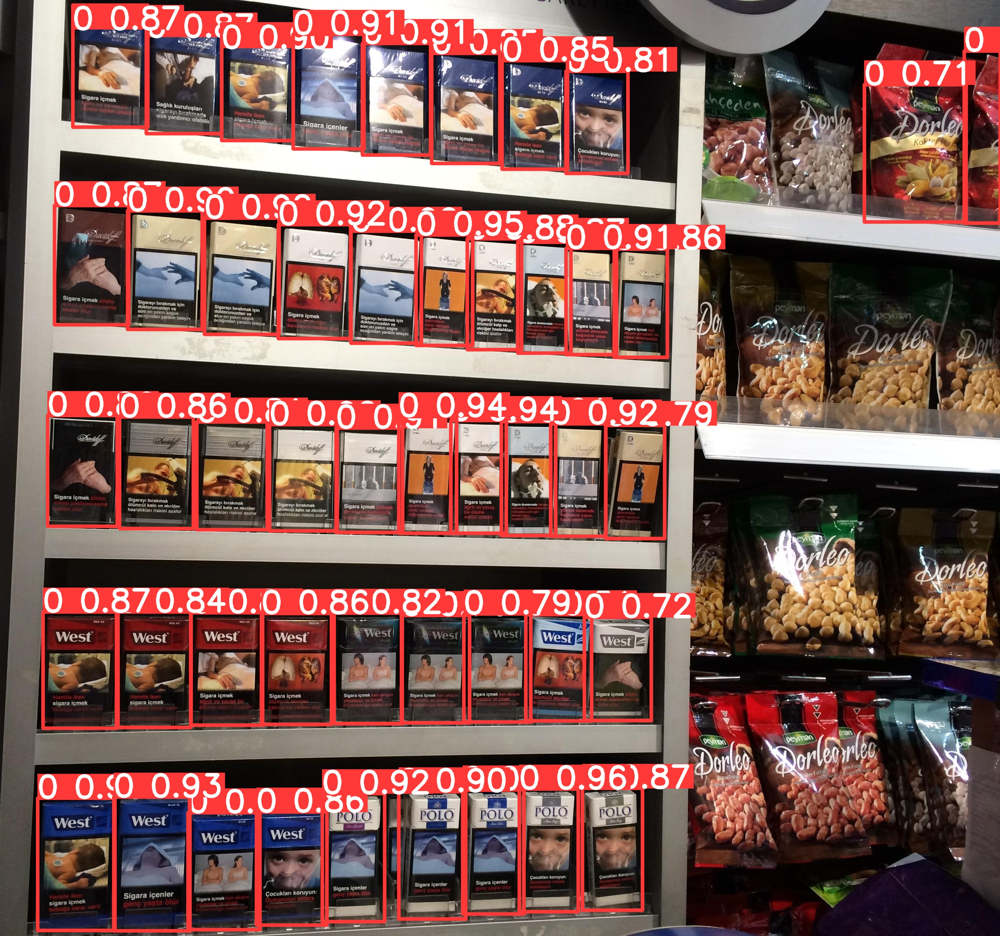

In [42]:

from google.colab.patches import cv2_imshow
import cv2
cv2_imshow(cv2.imread('/content/runs/detect/predict/C1_P02_N1_S5_1.JPG'))

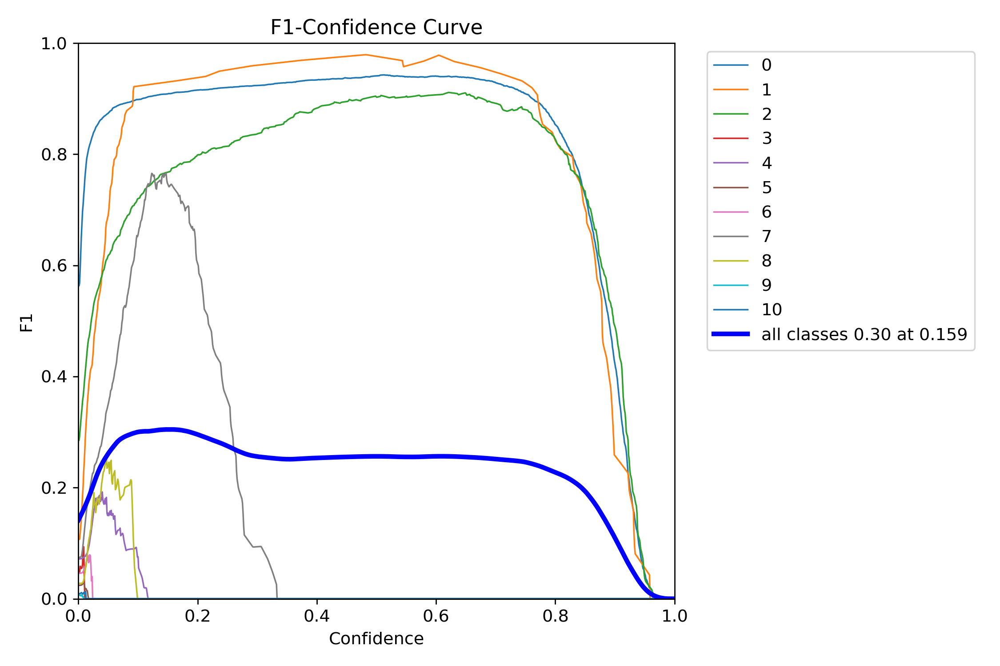

In [32]:
/content/runs/detect/predict/C1_P02_N1_S5_1.JPG
from google.colab.patches import cv2_imshow
import cv2
cv2_imshow(cv2.imread('/content/runs/detect/train/F1_curve.png'))

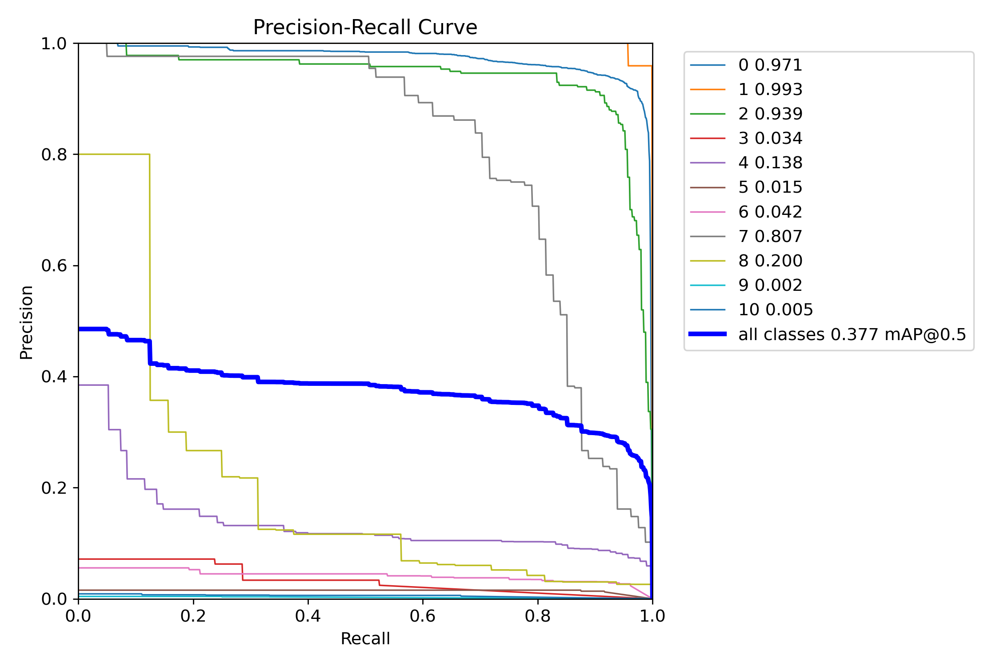

In [33]:

from google.colab.patches import cv2_imshow
import cv2
cv2_imshow(cv2.imread('/content/runs/detect/train/PR_curve.png'))

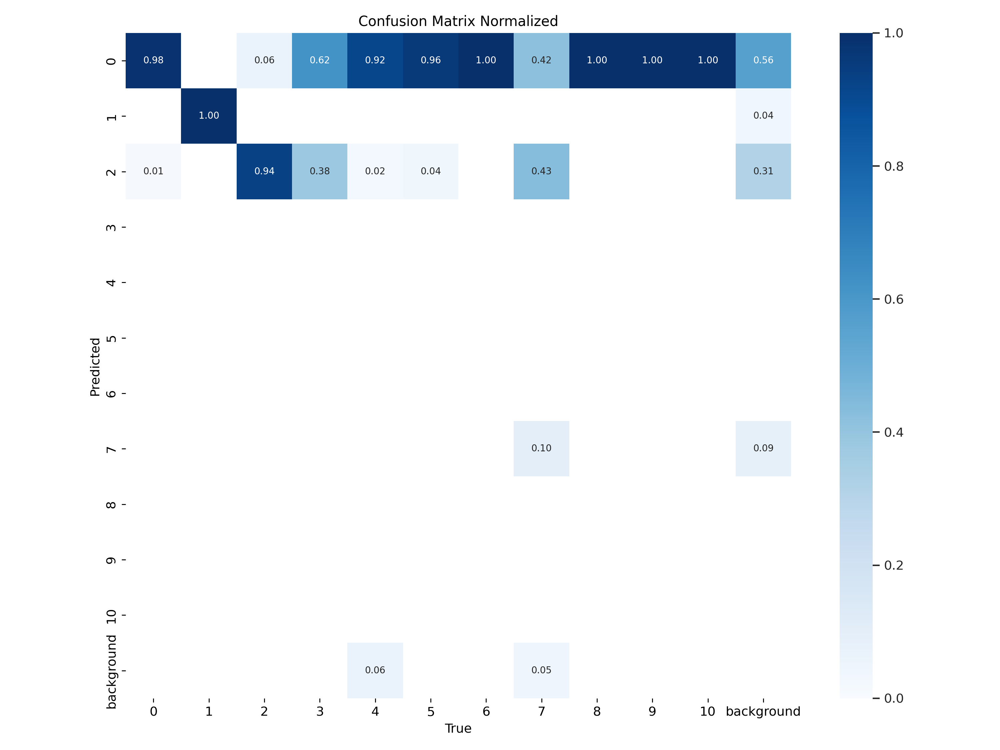

In [35]:

from google.colab.patches import cv2_imshow
import cv2
cv2_imshow(cv2.imread('/content/runs/detect/train/confusion_matrix_normalized.png'))

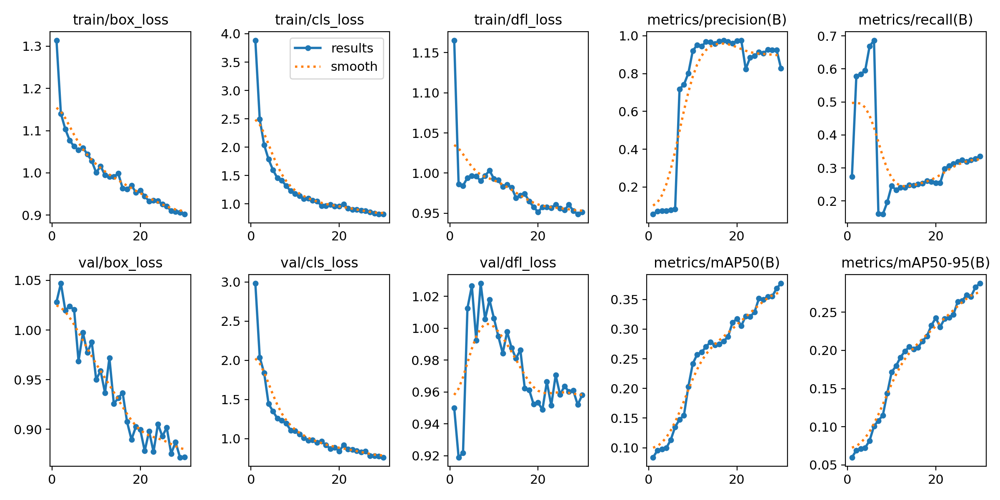

In [36]:

from google.colab.patches import cv2_imshow
import cv2
cv2_imshow(cv2.imread('/content/runs/detect/train/results.png'))


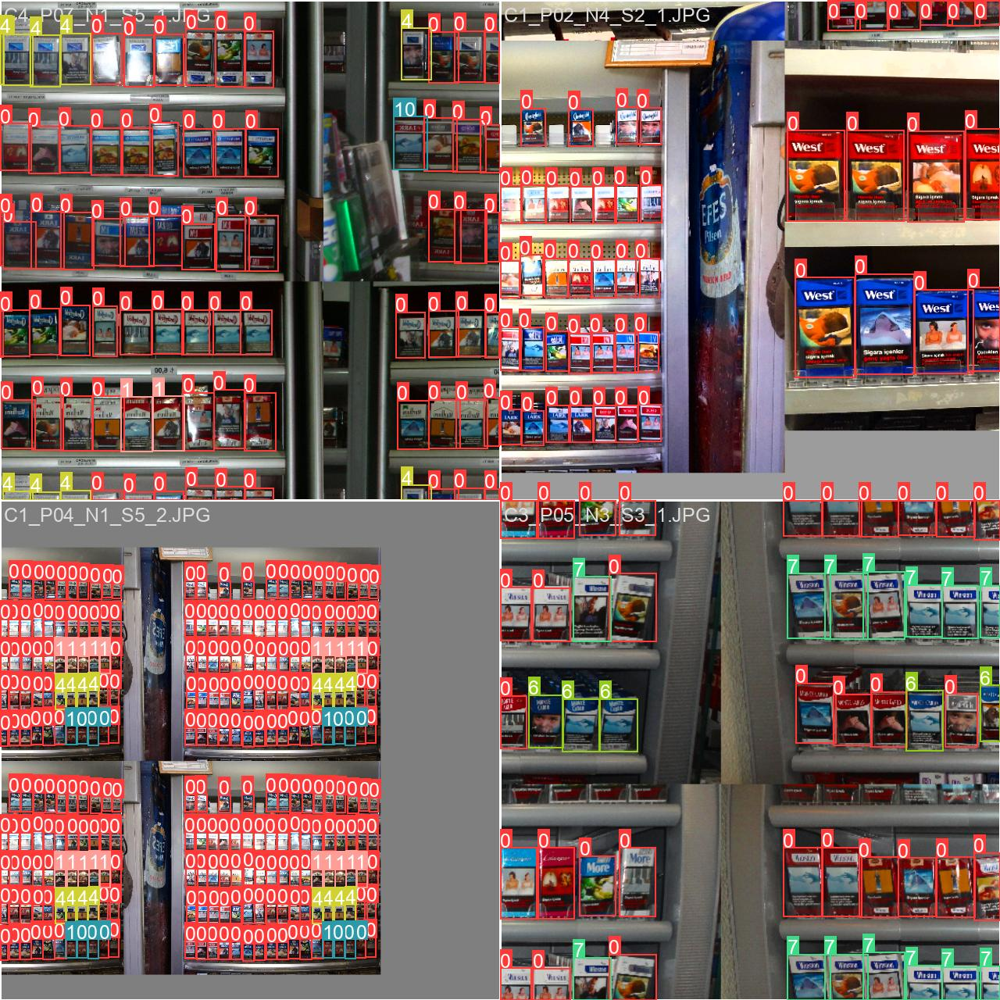

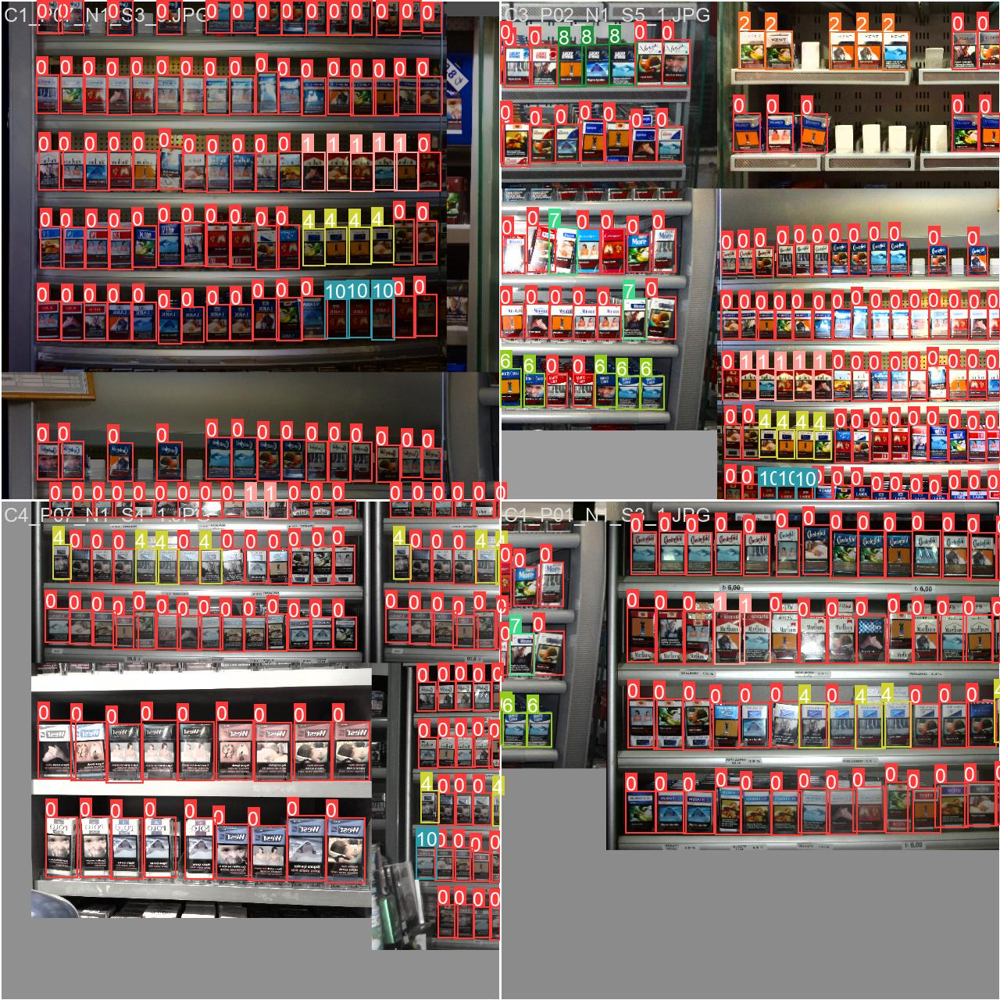

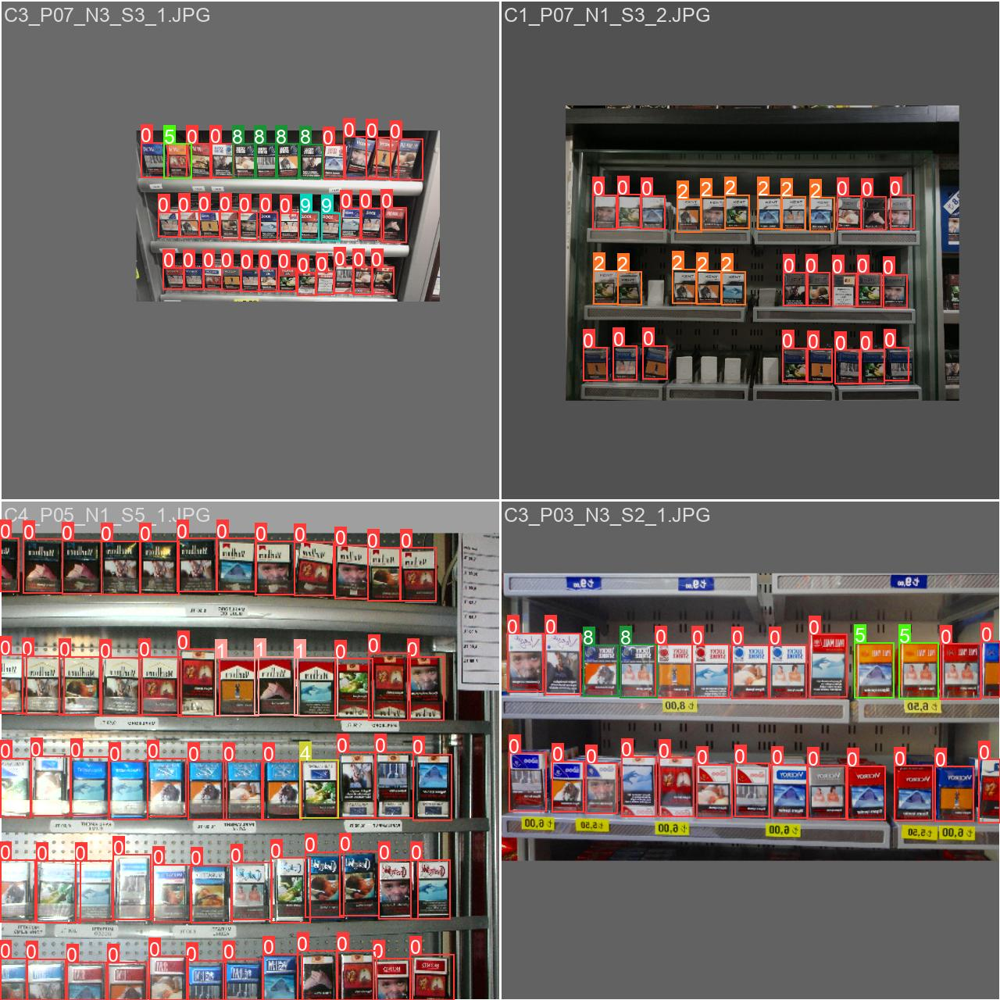

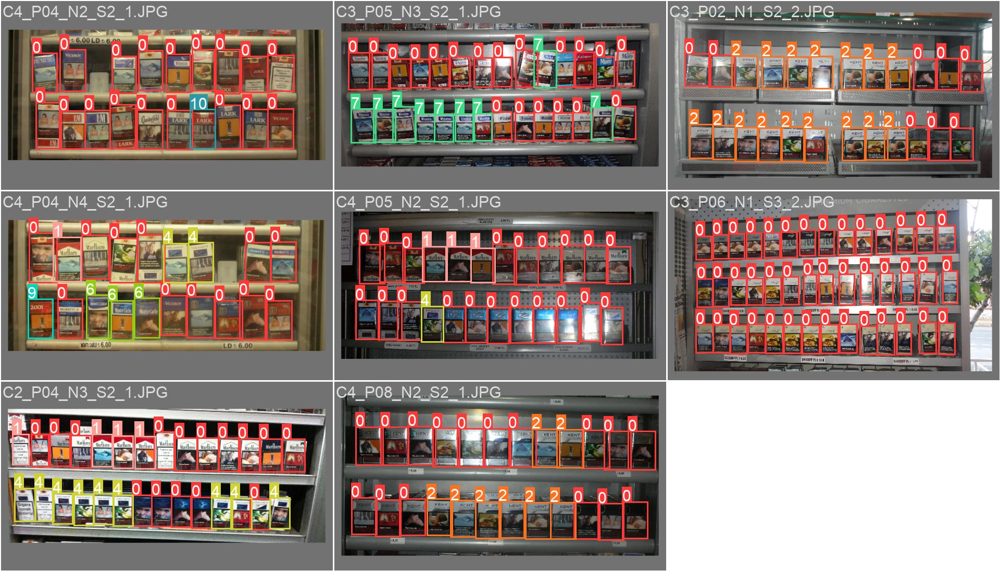

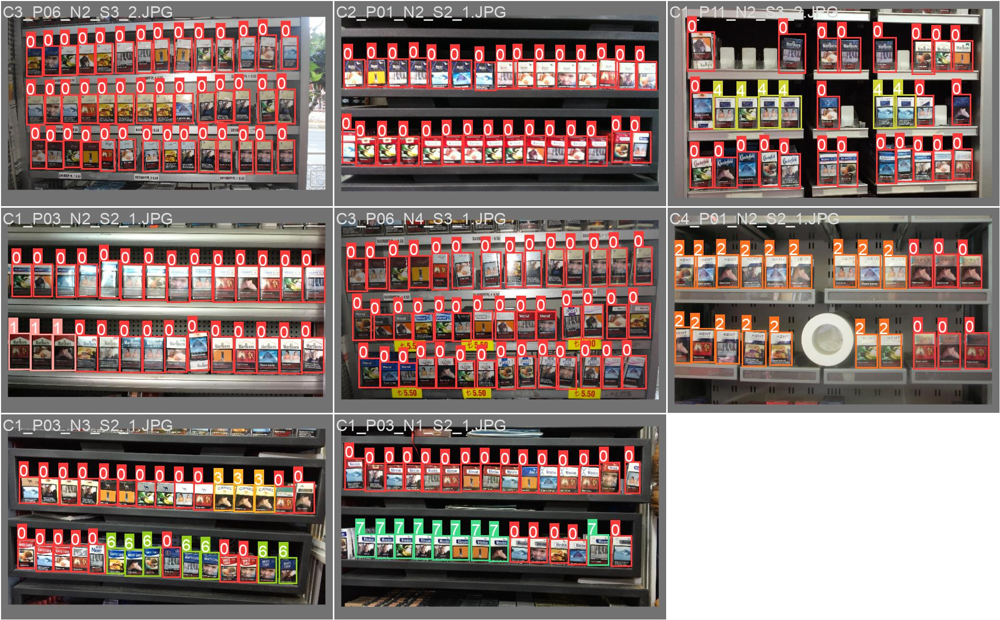

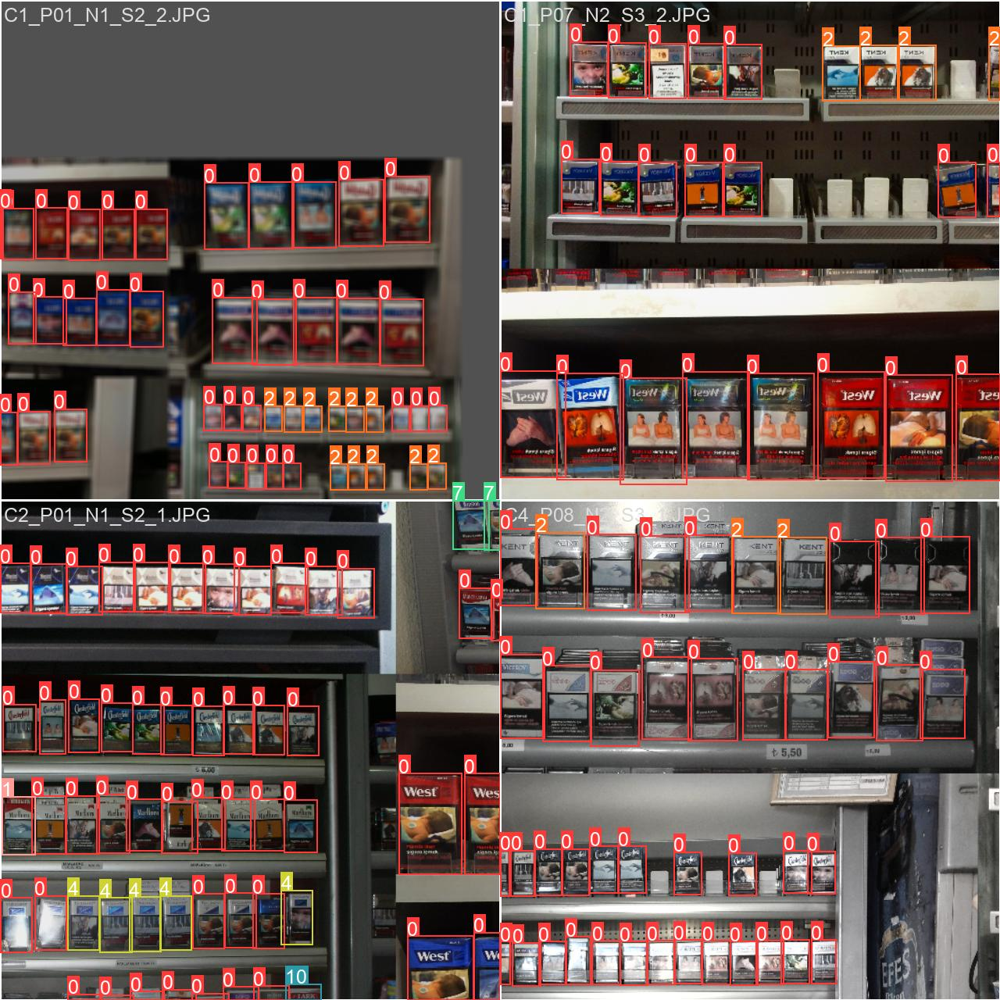

In [38]:
from google.colab.patches import cv2_imshow
import cv2
cv2_imshow(cv2.imread('/content/runs/detect/train/train_batch0.jpg'))
cv2_imshow(cv2.imread('/content/runs/detect/train/train_batch1.jpg'))
cv2_imshow(cv2.imread('/content/runs/detect/train/train_batch1420.jpg'))
cv2_imshow(cv2.imread('/content/runs/detect/train/val_batch0_labels.jpg'))
cv2_imshow(cv2.imread('//content/runs/detect/train/val_batch1_labels.jpg'))
cv2_imshow(cv2.imread('/content/runs/detect/train/train_batch2.jpg'))




